In [1]:
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt

[0.16343845 0.20774089 0.35413736 ... 0.16564368 0.1425273  0.2719729 ]


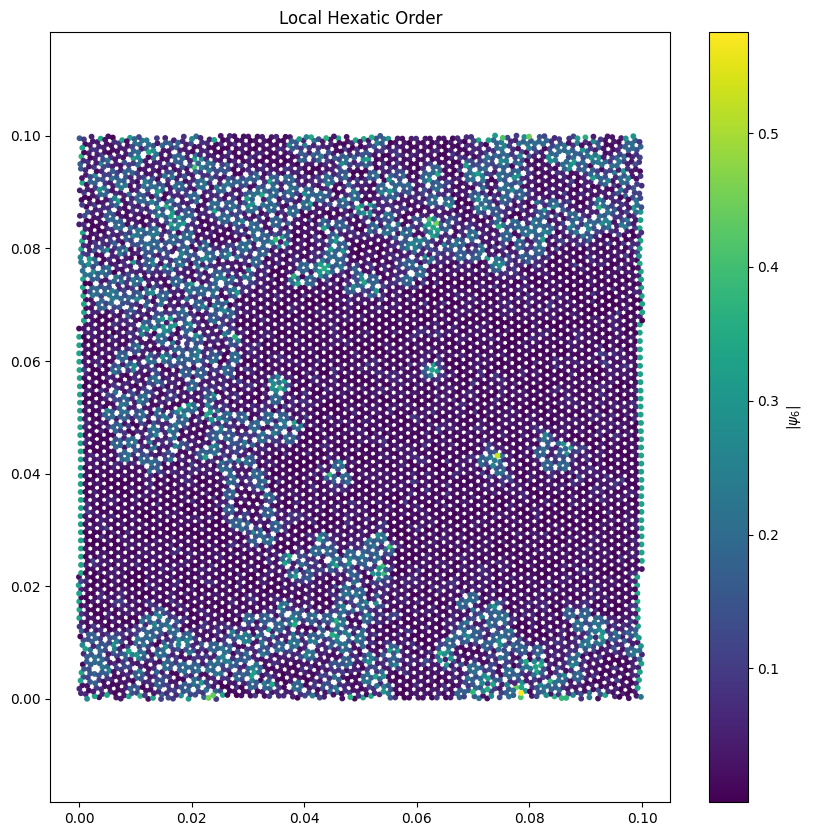

In [ ]:


T = 9690
traj = md.load_lammpstrj(f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj', top='graphene_topology.pdb')

# 2) Extract the first frame’s XY coords and embed in 3D (z=0)
xy = traj.xyz[-1, :, :2].astype(np.float32)       # (N,2)
points = np.zeros((xy.shape[0], 3), dtype=np.float32)
points[:, :2] = xy                               # (N,3)

# 3) Build a 2D box for freud by passing a length-2 list [Lx, Ly]
v1, v2, _ = traj.unitcell_vectors[0]
Lx, Ly = np.linalg.norm(v1), np.linalg.norm(v2)
box2d = [Lx, Ly]  # freud treats length-2 lists as 2D boxes :contentReference[oaicite:0]{index=0}

# 4) Compute per-particle hexatic order ψ₆
hexatic = freud.order.Hexatic(k=6)               # 2D hexatic (k-atic) order :contentReference[oaicite:1]{index=1}
hexatic.compute(system=(box2d, points))

psi6 = hexatic.particle_order                    # complex ψ₆ per particle
mag_psi6 = np.abs(psi6)                           # |ψ₆|
print(mag_psi6)

plt.figure(figsize=(10,10))
plt.scatter(points[:, 0], points[:, 1], c=mag_psi6, s=10, cmap='viridis')
plt.axis('equal')
plt.colorbar(label=r'$|\psi_6|$')
plt.title('Local Hexatic Order')
plt.show()


In [3]:
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import cKDTree

# 1) Your temp→S mapping
temp_to_S = {
    8350: 0.245,  8700: 0.483,  9250: 1.003,  9400: 1.627,
    9500: 1.827,  9669: 1.838,  9690: 3.826,  9700: 4.521,
    9750: 3.655,  9769: 2.301,  9785: 3.068,  9875: 4.454,
    9900: 4.058, 10020: 4.484, 10350: 4.910, 10800: 4.969,
   11000: 4.746
}

def classify_phase(S):
    if S < 1.5:    return "Crystalline"
    elif S <= 4.0: return "Hexatic"
    else:          return "Liquid"

phase_by_temp = {T: classify_phase(S) for T, S in temp_to_S.items()}


# 2) variance-based susceptibility on an arbitrary point‐set:
def chi6_variance(pos, r_cut, Lx, Ly):
    """
    pos:  (M,2) array of points *in one sub-box* of size Lx×Ly.
    returns (chi6_var, psi6_sub) computed with min‐image in that box.
    """
    M = pos.shape[0]
    if M < 10:
        return None  # too few particles to measure

    tree = cKDTree(pos, boxsize=(Lx, Ly))  # periodic
    # find all bonds within r_cut
    pairs = tree.sparse_distance_matrix(tree, r_cut, output_type="coo_matrix")
    i, j = pairs.row, pairs.col
    mask = i != j
    i, j = i[mask], j[mask]

    # minimum‐image bond vectors
    dxy = pos[j] - pos[i]
    # cKDTree with boxsize already did MI wrap for us

    # compute w = e^{6iθ}
    theta = np.arctan2(dxy[:,1], dxy[:,0])
    w     = np.exp(1j*6*theta)

    # accumulate per‐particle
    sums     = np.zeros(M, dtype=np.complex128)
    counts_i = np.zeros(M, dtype=int)
    np.add.at(sums,     i, w)
    np.add.at(counts_i, i, 1)

    psi6 = np.zeros(M, dtype=np.complex128)
    nz   = counts_i>0
    psi6[nz] = sums[nz]/counts_i[nz]

    mean_abs2 = np.mean(np.abs(psi6)**2)
    mean_psi  = np.mean(psi6)
    chi6_var  = M*(mean_abs2 - np.abs(mean_psi)**2)
    return chi6_var


# 3) Parameters for sub‐boxing
ngrid = 32       # split each frame into 16×16 sub‐boxes
r_cut = 1.2      # neighbor cutoff (graphene bond ~1.42/a normalized)
hexatic = freud.order.Hexatic(k=6)

# storage
phase_chi6var = {"Crystalline":[], "Hexatic":[], "Liquid":[]}

# 4) Loop over each T & its last 10 frames
for T, S in temp_to_S.items():
    phase = phase_by_temp[T]
    traj  = md.load_lammpstrj(f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj',
                               top='graphene_topology.pdb')

    # build global box dims
    v1, v2, _ = traj.unitcell_vectors[0]
    Lx, Ly    = np.linalg.norm(v1), np.linalg.norm(v2)

    # get last 10 frames
    for frame in traj[-1:]:
        xy = frame.xyz[0,:,:2].astype(np.float32)  # (N,2)

        # subdivide into ngrid×ngrid
        xs, ys = xy[:,0], xy[:,1]
        x0, x1 = xs.min(), xs.max()
        y0, y1 = ys.min(), ys.max()
        dx, dy = (x1-x0)/ngrid, (y1-y0)/ngrid

        for ix in range(ngrid):
            for iy in range(ngrid):
                lo_x, hi_x = x0+ix*dx, x0+(ix+1)*dx
                lo_y, hi_y = y0+iy*dy, y0+(iy+1)*dy

                mask = ( (xs>=lo_x)&(xs<hi_x)&(ys>=lo_y)&(ys<hi_y) )
                sub = xy[mask]
                if len(sub) < 20:
                    continue

                # shift into [0,dx)×[0,dy) for this sub‐box's local coords
                local = sub.copy()
                local[:,0] -= lo_x
                local[:,1] -= lo_y

                val = chi6_variance(local, r_cut, dx, dy)
                if val is not None:
                    phase_chi6var[phase].append(val)


for phase in ["Crystalline","Hexatic","Liquid"]:
    vals = np.array(phase_chi6var[phase])
    print(f"{phase:>10}:  mean={vals.mean():.3f},  σ={vals.std():.3f}")

# 5) Plot P(chi6_var) for each phase
plt.figure(figsize=(6,4))
# determine common bin edges
all_vals = np.hstack(list(phase_chi6var.values()))
bins = np.linspace(0, np.percentile(all_vals,95), 50)  # clip top 5%
styles = {"Crystalline":"-","Hexatic":"--","Liquid":":"}

for phase in ["Crystalline","Hexatic","Liquid"]:
    data = np.array(phase_chi6var[phase])
    plt.hist(data, bins=bins, density=True, histtype='step',
             linestyle=styles[phase], linewidth=2, label=phase)

plt.xlabel(r"$\tilde\chi_6$ (local variance)", fontsize=14)
plt.ylabel(r"$P(\tilde\chi_6)$", fontsize=14)
plt.axvline(vals.mean(),  color='k', linestyle=':')
plt.legend()
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


C:\Users\David\AppData\Local\Temp\ipykernel_1948\2292166525.py:115: RuntimeWarning: Mean of empty slice.
  print(f"{phase:>10}:  mean={vals.mean():.3f},  σ={vals.std():.3f}")
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\numpy\_core\_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\numpy\_core\_methods.py:223: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\numpy\_core\_methods.py:181: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
c:\Users\David\anaconda3\envs\freud311\Lib\site-packages\numpy\_core\_methods.py:215: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Crystalline:  mean=nan,  σ=nan
   Hexatic:  mean=nan,  σ=nan
    Liquid:  mean=nan,  σ=nan


IndexError: index -1 is out of bounds for axis 0 with size 0

<Figure size 600x400 with 0 Axes>

In [7]:
import numpy as np
import mdtraj as md
import freud
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

# Your four temperatures
temps = [(8700, "0.598", 10), (9750, "3.665",1.7e3), (9900, "4.058",1.7e3), (11000, "4.746",1.7e3)]

fig = plt.figure(figsize=(14, 14), dpi=800)

# Create a 2×2 grid; axes_pad controls BOTH horiz & vert spacing.
# cbar_mode='single' makes one colorbar.  cbar_location & cbar_pad place it.
grid = ImageGrid(
    fig, 111,                    # whole-figure, 1×1 grid placeholder
    nrows_ncols=(2, 2),          # your panel layout
    axes_pad=0.5,                # spacing between panels
    share_all=True,              # share x & y limits
    cbar_mode='single',          # one colorbar for all
    cbar_location='right',       # put it on the right
    cbar_pad=0.1                 # space between panels and colorbar
)

# Loop through each axes in the grid
for ax, (T, G, s) in zip(grid, temps):
    # 1) Load trajectory
    traj = md.load_lammpstrj(
        f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj',
        top='graphene_topology.pdb'
    )

    # 2) Extract final x,y
    xy = traj.xyz[-1, :, :2].astype(np.float32)
    points = np.zeros((xy.shape[0], 3), np.float32)
    points[:, :2] = xy

    # 3) Build freud box
    v1, v2, _ = traj.unitcell_vectors[0]
    box2d = [np.linalg.norm(v1), np.linalg.norm(v2)]

    # 4) Compute hexatic order
    hexatic = freud.order.Hexatic(k=6)
    hexatic.compute(system=(box2d, points))
    mag_psi6 = np.abs(hexatic.particle_order)

    # 5) Scatter
    sc = ax.scatter(
        points[:, 0] * s,
        points[:, 1] * s,
        c=mag_psi6, s=6, cmap='viridis'
    )

    # Uniform axes limits & aspect
    ax.set_xlim(0, 170)
    ax.set_ylim(0, 170)
    ax.set_aspect('equal')
    ax.set_title(rf"$\Gamma$ = {G}", pad=6, fontsize=30)



# Add axis labels on the remaining axes
grid[2].set_xlabel(r"$x$ (Å)", fontsize=30)
grid[3].set_xlabel(r"$x$ (Å)", fontsize=30)
grid[0].set_ylabel(r"$y$ (Å)", fontsize=30)
grid[2].set_ylabel(r"$y$ (Å)", fontsize=0)

# Create the single colorbar in the grid’s cbar_axes[0]
cbar = grid.cbar_axes[0].colorbar(sc)
cbar.set_label(r"$|\psi_6|$", fontsize=30)

plt.savefig("../output/local_hexatic_order.png",dpi=800)
plt.show()


In [ ]:
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt

# 1) Load your trajectory & topology
T = 9690
traj = md.load_lammpstrj(f'../output/GAMMAS/{T}/graphene_{T}.lammpstrj',
                         top='graphene_topology.pdb')

# 2) Extract the last frame’s XY coords (z=0)
xy = traj.xyz[-1, :, :2].astype(np.float32)       # (N,2)
points = np.zeros((xy.shape[0], 3), dtype=np.float32)
points[:, :2] = xy                                # (N,3)

# 3) Build a 2D periodic box from your unit cell
v1, v2, _ = traj.unitcell_vectors[0]
Lx, Ly = np.linalg.norm(v1), np.linalg.norm(v2)
box2d = [Lx, Ly]  # freud treats length-2 lists as 2D boxes

# 4) Instantiate the BondOrder “diagram” object
#    l=6 for hexagonal order; r_max just beyond 1st neighbor shell
#    n_r, n_theta control the histogram resolution (feel free to tweak)
bod = freud.environment.BondOrder(
    l=6,
    r_max=1.5,
    n_r=50,
    n_theta=180,
)

# 5) Compute the 2D bond-order histogram, using 12 neighbors per particle
res = bod.compute(
    system=(box2d, points),
    neighbors={'num_neighbors': 12}
)

# 6) Extract and clip the bond_order array for plotting
bod_array = res.bond_order
# Clip top 1% to avoid outliers dominating the color scale
bod_array = np.clip(bod_array, 0, np.percentile(bod_array, 99))

# 7) Plot exactly as in the docs
plt.figure(figsize=(6, 6))
plt.imshow(
    bod_array.T,
    origin='lower',
    aspect='auto',
    interpolation='nearest'
)
plt.xlabel('Radial bin $i$')
plt.ylabel('Angular bin $j$')
plt.title(r'Bond Order Diagram $\psi_6(r, \theta)$')
plt.colorbar(label='Probability density')
plt.tight_layout()
plt.show()


In [ ]:
import MDAnalysis as mda
import mdtraj as md
import freud
import numpy as np
import matplotlib.pyplot as plt
u = mda.Universe('../output/GAMMAS/300/anneal_300K.lammpstrj', format='LAMMPSDUMP')
u.atoms.write('graphene_topology.pdb')
print("Conversion complete: 'system.pdb' created.")

In [3]:
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Computer Modern"],
    # optionally make all font sizes a bit larger for publication
    "font.size": 14,
    "axes.labelsize": 14,
    "xtick.labelsize": 16,
    "ytick.labelsize": 16,
    "legend.fontsize": 12,
})

plt.rc('xtick', labelsize=16)
plt.rc('ytick', labelsize=16)